<a href="https://colab.research.google.com/github/talktokorea/Anomaly_Detection/blob/main/Copy_of_Image_Scene_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Upload kaggle.json API token, and download / unzip intel-image-classification dataset

!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d puneet6060/intel-image-classification
!unzip intel-image-classification.zip

In [ ]:
import cv2

building = cv2.imread('seg_train/seg_train/buildings/10006.jpg')
building.shape

(150, 150, 3)

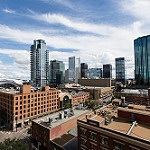

In [ ]:
from google.colab.patches import cv2_imshow

cv2_imshow(building)

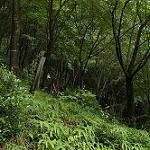

In [ ]:
forest = cv2.imread('seg_train/seg_train/forest/10007.jpg')
cv2_imshow(forest)

In [ ]:
import os

class_folder_paths = ['seg_train/seg_train/' + x for x in os.listdir('seg_train/seg_train/')]
class_folder_paths

In [ ]:
for class_folder_path in class_folder_paths:
  print('{0}: '.format(class_folder_path), len(os.listdir(class_folder_path)))

In [ ]:
TRAIN_DIR = 'seg_train/seg_train/'
VAL_DIR = 'seg_test/seg_test/'

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_data_gen = ImageDataGenerator(horizontal_flip=True)

train_generator = train_data_gen.flow_from_directory(TRAIN_DIR,
                                                     target_size=(150, 150),
                                                     color_mode='rgb',
                                                     batch_size=32,
                                                     class_mode='categorical',
                                                     shuffle=True)

val_data_gen = ImageDataGenerator()
val_generator = val_data_gen.flow_from_directory(VAL_DIR,
                                                target_size=(150,150),
                                                color_mode='rgb',
                                                batch_size=32,
                                                class_mode='categorical',
                                                shuffle=False)

Found 14034 images belonging to 6 classes.
Found 3000 images belonging to 6 classes.


In [ ]:
labels = train_generator.class_indices
class_mapping = dict((v,k) for k, v in labels.items())
class_mapping

{0: 'buildings',
 1: 'forest',
 2: 'glacier',
 3: 'mountain',
 4: 'sea',
 5: 'street'}

In [ ]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Lambda, GlobalAveragePooling2D, Dropout, Dense


before_mobilenet = Sequential([Input((150, 150, 3)),
                               Lambda(preprocess_input)])

mobilenet = MobileNetV2(input_shape=(150, 150, 3), include_top=False)

after_mobilenet = Sequential([GlobalAveragePooling2D(),
                              Dropout(0.3),
                              Dense(6, activation='softmax')])

model = Sequential([before_mobilenet, mobilenet, after_mobilenet])

9420800/9406464 [==============================] - 0s 0us/step


In [ ]:
from tensorflow.keras.optimizers import Adam

opt = Adam(learning_rate=0.00001)

model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
model.build(((None, 150, 150, 3)))


before_mobilenet.summary()
mobilenet.summary()
after_mobilenet.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lambda (Lambda)             (None, 150, 150, 3)       0         
                                                                 
Total params: 0
Trainable params: 0
Non-trainable params: 0
_________________________________________________________________
Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 75, 75, 32)   864         

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

train_cb = ModelCheckpoint('model/', save_best_only=True)

model.fit(train_generator, validation_data=val_generator, callbacks=[train_cb], epochs=7)

In [ ]:
!zip -r model.zip model/

  adding: model/ (stored 0%)
  adding: model/keras_metadata.pb (deflated 96%)
  adding: model/saved_model.pb (deflated 92%)
  adding: model/assets/ (stored 0%)
  adding: model/variables/ (stored 0%)
  adding: model/variables/variables.index (deflated 79%)
  adding: model/variables/variables.data-00000-of-00001 (deflated 9%)


In [ ]:
import tensorflow as tf

converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()
tflite_model

INFO:tensorflow:Assets written to: /tmp/tmpgzivktuy/assets


b'\x1c\x00\x00\x00TFL3\x14\x00 \x00\x04\x00\x08\x00\x0c\x00\x10\x00\x14\x00\x00\x00\x18\x00\x1c\x00\x14\x00\x00\x00\x03\x00\x00\x00\x18\x00\x00\x00<\x00\x00\x00\x08\x04\x00\x00<\x00\x00\x00\xb0\x03\x00\x00\x1c\x03\x00\x00\t\x00\x00\x00\xd8d\x00\x00\x10d\x00\x00\x9cb\x00\x00\xe4`\x00\x00\xd0\\\x00\x00\x98T\x00\x00\xc4\t\x00\x00\xf8\x08\x00\x00\\\x08\x00\x00\x01\x00\x00\x00\xf0\x03\x00\x00\xb9\x00\x00\x00`\xd1\x87\x00\\\xd1\x87\x00p\xd0\x87\x00\xe0\xcf\x87\x00D\xcf\x87\x00\xe8\xce\x87\x00P\xce\x87\x00\xb8\xcd\x87\x00\xc8\xcc\x87\x00\xc4\xcb\x87\x00\xc8\xc9\x87\x00\xcc\xc7\x87\x00\x10\xc5\x87\x00T\xc2\x87\x00\x98\xbf\x87\x00\xdc\xbc\x87\x00`\xb9\x87\x00\xe4\xb5\x87\x00h\xb2\x87\x00\xec\xae\x87\x00p\xab\x87\x00\xf4\xa7\x87\x00x\xa1\x87\x00\xfc\x9a\x87\x00\x80\x94\x87\x00\x04\x8e\x87\x00\x88\x87\x87\x00\x0c\x81\x87\x00\x90z\x87\x00\x10t\x87\x00\x94j\x87\x00\x14a\x87\x00\x98W\x87\x00\x18N\x87\x00\x9cD\x87\x00\x1c;\x87\x00\xa0+\x87\x00 \x1c\x87\x00\xa4\x0c\x87\x00$\xfd\x86\x00\xa8\xed\x86\x00

In [ ]:
with open('model.tflite', 'wb') as f:
  f.write(tflite_model)

In [ ]:
import cv2
import numpy as np


inp1 = cv2.imread('seg_test/seg_test/forest/20056.jpg')
inp2 = cv2.imread('seg_test/seg_test/forest/20062.jpg')

inps = [inp1, inp2]
inps

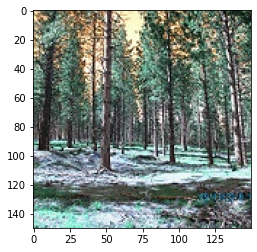

In [ ]:
import matplotlib.pyplot as plt


plt.imshow(inps[1])

In [ ]:
inps = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in inps]
inps

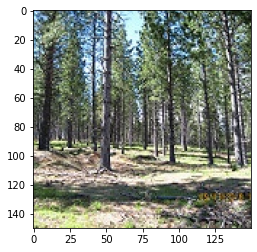

In [ ]:
plt.imshow(inps[1])

In [ ]:
inps = np.array(inps)
inps.shape

(2, 150, 150, 3)

In [ ]:
!pip install tflite_runtime

     |████████████████████████████████| 2.2 MB 5.5 MB/s 


In [ ]:
import tflite_runtime.interpreter as tflite

model = tflite.Interpreter("model.tflite")
model

In [ ]:
model.allocate_tensors()

input_details = model.get_input_details()
input_details

[{'dtype': numpy.float32,
  'index': 0,
  'name': 'serving_default_sequential_input:0',
  'quantization': (0.0, 0),
  'quantization_parameters': {'quantized_dimension': 0,
   'scales': array([], dtype=float32),
   'zero_points': array([], dtype=int32)},
  'shape': array([  1, 150, 150,   3], dtype=int32),
  'shape_signature': array([ -1, 150, 150,   3], dtype=int32),
  'sparsity_parameters': {}}]

In [ ]:
output_details = model.get_output_details()
output_details

[{'dtype': numpy.float32,
  'index': 182,
  'name': 'StatefulPartitionedCall:0',
  'quantization': (0.0, 0),
  'quantization_parameters': {'quantized_dimension': 0,
   'scales': array([], dtype=float32),
   'zero_points': array([], dtype=int32)},
  'shape': array([1, 6], dtype=int32),
  'shape_signature': array([-1,  6], dtype=int32),
  'sparsity_parameters': {}}]

In [ ]:
# create function to get class predictions

def model_predict(images_arr):
    predictions = [0] * len(images_arr)

    for i, val in enumerate(predictions):
        model.set_tensor(input_details[0]['index'], images_arr[i].reshape((1, 150, 150, 3)))
        model.invoke()
        predictions[i] = model.get_tensor(output_details[0]['index']).reshape((6,))
    
    prediction_probabilities = np.array(predictions)
    argmaxs = np.argmax(prediction_probabilities, axis=1)

    return argmaxs

In [ ]:
model_predict(inps.astype(np.float32))

array([1, 1])